In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import keras, time, sys, os, gc

DTYPE_OP = 'float32'
keras.backend.set_floatx(DTYPE_OP)

if DTYPE_OP == 'float64':
    keras.backend.set_epsilon(np.finfo(np.float64).eps)
elif DTYPE_OP == 'float32':
    keras.backend.set_epsilon(np.finfo(np.float32).eps)

Using TensorFlow backend.


In [2]:
#GLOBAL Variables
BATCH_SIZE = 64
EPOCHS_BASE = 50
OPT = 'adam' #optimizer for neural network 
TOL = 3e-2

In [3]:
folder ="../FG-Net_Age/"
columns = ["GT","file name","a1","a2","a3","a4","a5","a6","a7","a8","a9","a10"]

### Load Data and preprocess

In [4]:
## mas anotaciones ne este dataset: http://yekara.com/age_annotations/

In [5]:
df_ann = pd.read_csv(folder+"fgnet_age_estimations.csv",header=None,names=columns)
gt_aux = df_ann["GT"].values

file_names = []
for value in df_ann["file name"].values:
    aux = value[7:-4].replace("_", '')
    if "M" in aux:
        split_v = "M"
    elif "F" in aux:
        split_v = "F"
    subject, age = aux.split(split_v)
    file_names.append( subject.zfill(3)+ "A"+ age.zfill(2)+".JPG" )
file_names

['022A18.JPG',
 '065A09.JPG',
 '034A25.JPG',
 '066A11.JPG',
 '034A30.JPG',
 '054A13.JPG',
 '031A16.JPG',
 '081A00.JPG',
 '039A19.JPG',
 '039A07.JPG',
 '062A35.JPG',
 '038A10.JPG',
 '008A13.JPG',
 '049A04.JPG',
 '025A19.JPG',
 '007A37.JPG',
 '066A00.JPG',
 '017A22.JPG',
 '015A14.JPG',
 '076A11.JPG',
 '034A44.JPG',
 '045A06.JPG',
 '077A14.JPG',
 '043A03.JPG',
 '014A40.JPG',
 '047A23.JPG',
 '002A26.JPG',
 '028A41.JPG',
 '066A04.JPG',
 '040A21.JPG',
 '015A00.JPG',
 '082A20.JPG',
 '024A07.JPG',
 '043A23.JPG',
 '005A30.JPG',
 '039A15.JPG',
 '002A04.JPG',
 '013A23.JPG',
 '061A18.JPG',
 '078A13.JPG',
 '056A12.JPG',
 '022A26.JPG',
 '027A02.JPG',
 '015A10.JPG',
 '078A11.JPG',
 '042A00.JPG',
 '041A04.JPG',
 '072A29.JPG',
 '004A37.JPG',
 '006A28.JPG',
 '065A02b.JPG',
 '074A01.JPG',
 '071A44.JPG',
 '078A02.JPG',
 '076A12.JPG',
 '015A12.JPG',
 '008A35.JPG',
 '032A10.JPG',
 '009A16a.JPG',
 '052A18.JPG',
 '002A36.JPG',
 '006A55.JPG',
 '046A20.JPG',
 '049A08.JPG',
 '075A06.JPG',
 '054A11.JPG',
 '003A47

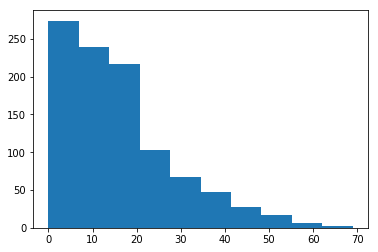

Minimum data on split:  250.5
Splits obtained:  4
Splits obtained ammount:  [274, 271, 266, 0]


array([ 0.,  7., 15., 26., inf])

In [6]:
## discretizar..
plt.hist(gt_aux)
plt.show()

##stratified range..
limits = [0]
pos_values = np.unique(gt_aux)

N = gt_aux.shape[0]
splits = 4 #5 ,7,8
acum_split = []
data_by_split = N/(splits) #minimum data on split
print("Minimum data on split: ",data_by_split)

for i in range(splits-1):
    if i != len(limits)-1:
        break
    upper_values = pos_values[pos_values>=limits[i]]
    for value in upper_values: #find the upper limit
        range_v = (limits[i] <= gt_aux ) & (gt_aux < value)
        if np.sum(range_v) >= data_by_split:
            limits.append(value)
            acum_split.append(np.sum(range_v))
            break
range_v = (limits[-1] <= gt_aux ) & (gt_aux <=1)
up_lim = np.inf #max(np.max(pos_values), df_ann.iloc[:,2:].values.max())+0.01
limits.append(up_lim)
acum_split.append(np.sum(range_v))
limits = np.asarray(limits)

print("Splits obtained: ",len(acum_split))
print("Splits obtained ammount: ",acum_split)
limits

In [7]:
limits = [0, 9, 16, 25, 35, 45, np.inf ]
"""
    Children (1-14) CLASS 0
    Youth (14-25) CLASS 1
    ADULTS (25-40) CLASS 2
    Middle age (40-60) CLASS 3
    Very Old (>60) CLASS 4
"""

'\n    Children (1-14) CLASS 0\n    Youth (14-25) CLASS 1\n    ADULTS (25-40) CLASS 2\n    Middle age (40-60) CLASS 3\n    Very Old (>60) CLASS 4\n'

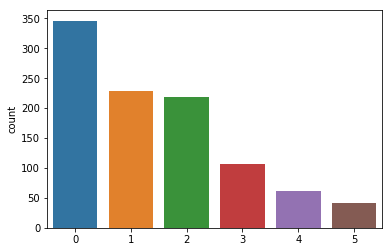

In [8]:
def continous_2_cat(data):
    if data == -1:
        return -1
    return np.where(limits <= data )[0][-1]

Z_data = np.zeros((df_ann.shape[0]), dtype='int')
for i in range(Z_data.shape[0]):
    Z_data[i] = continous_2_cat(gt_aux[i]) #int(gt_aux[i]/10)
K = Z_data.max()+1

sns.countplot(Z_data)
plt.show()

### buscando test

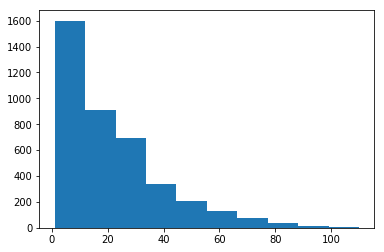

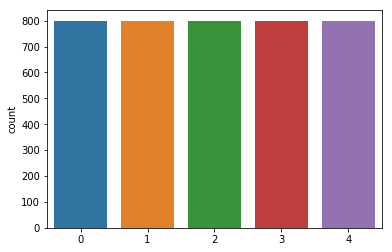

{0: 800, 1: 800, 2: 800, 3: 800, 4: 800}

In [10]:
folder_img_te = "/home/fmena/Downloads/UTKFace/"
file_images_te = os.listdir(folder_img_te)

gt_aux_c = []
Z_data_te = []
file_names_te = []
count_v = {k:0 for k in range(K)}
for value in file_images_te:
    #age, gender, race, id_jpg = value.split("_")
    age = float(value.split("_")[0])
    age_cat = continous_2_cat(age)
    
    if count_v[age_cat] < 800: #semi-balanceado..
        gt_aux_c.append(age)
        Z_data_te.append(age_cat)
        file_names_te.append(value)
        
        count_v[Z_data_te[-1]] +=1
Z_data_te = np.asarray(Z_data_te)

## discretizar..
plt.hist(gt_aux_c)
plt.show()
sns.countplot(Z_data_te)
plt.show()

count_v

In [9]:
from PIL import Image
folder_img = folder+"FGNET/images/"
X_images = []
for i,values in enumerate(file_names):
    I = Image.open(folder_img+values).convert("RGB") 
    I = I.resize((224,224), Image.ANTIALIAS) #reshape it
    #print(I.size)
    X_images.append(np.asarray(I).astype("uint8"))
    I.close()
gc.collect()
X_images = np.asarray(X_images)
print("Images shapes: ",X_images.shape)

Images shapes:  (1002, 224, 224, 3)


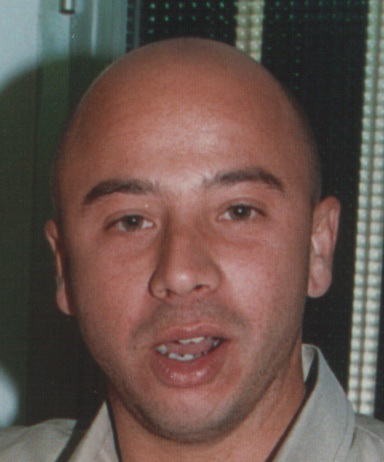

In [43]:
from PIL import Image
Image.open(folder+"FGNET/images/035A23a.JPG")

In [6]:
pool_mo = "avg"

#now pass through VGG
from code.learning_models import through_VGG, through_InceptionV3
new_X = through_VGG(X_images.astype('float32'), pooling_mode=pool_mo)
#new_X = through_InceptionV3(X_images.astype('float32'), pooling_mode=pool_mo)
print("New shape through VGG: ",new_X.shape)
new_X

New shape through VGG:  (1002, 512)


array([[0.        , 0.        , 0.        , ..., 0.30005205, 0.01534462,
        0.66252375],
       [0.        , 0.        , 0.3823775 , ..., 4.5461593 , 2.617739  ,
        0.02364997],
       [0.        , 0.        , 0.        , ..., 1.6080321 , 1.9697523 ,
        0.18695028],
       ...,
       [0.        , 0.46689925, 0.        , ..., 1.0656335 , 0.03819171,
        0.14722537],
       [0.        , 0.22692089, 0.58484757, ..., 2.0427058 , 0.28857392,
        0.32262632],
       [0.        , 0.        , 0.706046  , ..., 5.170857  , 0.44488853,
        0.7249939 ]], dtype=float32)

In [10]:
pool_mo = None #"avg"

from code.learning_models import through_CNNFace
#"senet50" # 'vgg16', "resnet50", "senet50"
new_X = through_CNNFace(X_images.astype('float32'), weights_path="vgg16",pooling_mode=pool_mo)

print("New shape through VGG: ",new_X.shape)
new_X

New shape through VGG:  (1002, 7, 7, 512)


array([[[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        

In [19]:
pool_mo = None #"avg"

from code.learning_models import through_CNNFace
#"senet50" # 'vgg16', "resnet50", "senet50"
new_X_te = through_CNNFace(X_images_te.astype('float32'), weights_path="vgg16",pooling_mode=pool_mo)

print("New shape through VGG: ",new_X_te.shape)
new_X_te

NameError: name 'X_images_te' is not defined

In [ ]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
new_X = std.fit_transform(new_X)
#new_X_te = std.transform(new_X_te)
new_X

In [4]:
X = #np.load(folder+"GalaxyZoo_data.npy")
X.shape

(61578, 80, 80, 3)

### Load annotations / Generate

In [11]:
df_ann = pd.read_csv(folder+"fgnet_age_estimations.csv",header=None,names=columns)

r_obs = np.zeros((df_ann.shape[0],K))
for i,anns in enumerate(df_ann.iloc[:,2:].values):
    for value in anns:
        r_obs[i, continous_2_cat(value) ] +=1
r_obs

array([[0., 0., 7., 2., 0., 1.],
       [3., 7., 0., 0., 0., 0.],
       [0., 0., 3., 5., 2., 0.],
       ...,
       [0., 2., 6., 2., 0., 0.],
       [0., 0., 1., 4., 3., 2.],
       [0., 0., 7., 3., 0., 0.]])

In [11]:
#http://chenlab.ece.cornell.edu/people/Andy/ImagesOfGroups.html
import scipy.io as sio
mat_train = sio.loadmat("/home/fmena/Downloads/eventrain.mat")
mat_test = sio.loadmat("/home/fmena/Downloads/eventest.mat")
data_train= mat_train["trcoll"][0][0]
data_test= mat_test["tecoll"][0][0]

In [90]:
data_train[5].shape

(3500, 2989)

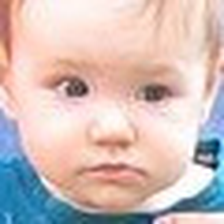

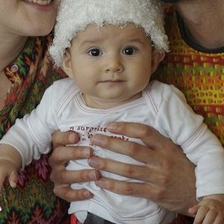

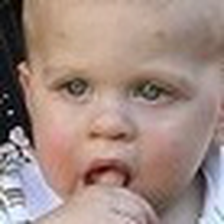

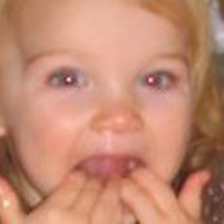

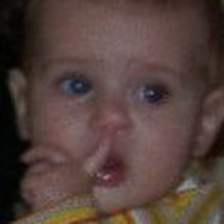

...

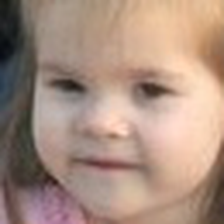

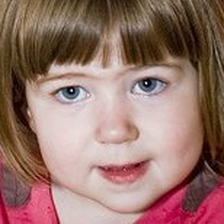

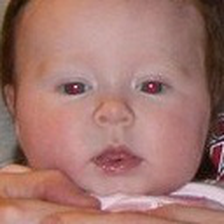

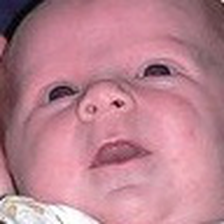

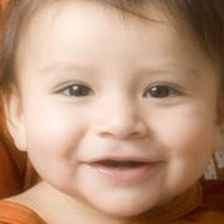

KeyboardInterrupt: 

In [38]:
from IPython.core.display import display
ageClass = []
X_images_te = []
for value in ["1","5","10","16","28","51","75"]:
    aux_f = folder+"/ImgGroups/"+value
    for name in os.listdir(aux_f):
        age_test.append(float(value))
        
        I = Image.open(aux_f+"/"+name).convert("RGB") 
        I = I.resize((224,224), Image.ANTIALIAS) #reshape it
        display(I)
        #print(I.size)
        X_images_te.append(np.asarray(I).astype("uint8"))
        I.close()

X_images_te = np.asarray(X_images_te)
ageClass = np.asarray(ageClass)
print("Images test shapes: ",X_images_te.shape)

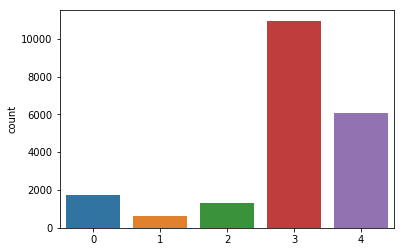

In [33]:
ageClass = np.concatenate([data_train[1], data_test[1]])[:,0] #target

Z_aux = np.zeros((ageClass.shape[0]), dtype='int')
for i in range(Z_aux.shape[0]):
    Z_aux[i] = continous_2_cat(ageClass[i]) #int(gt_aux[i]/10)
    
sns.countplot(Z_aux)
plt.show()

In [92]:
aux = sio.loadmat("/home/fmena/Downloads/MatlabFiles/Fam2a.mat")
aux["coll"]

array([[(array([[(array(['c:\\research\\flickr\\query_groupShots\\Q4\\FamilyPortraitRel1\\1000306439_a1744969b8_1369_11099615@N00.jpg'],
      dtype='<U101'), array(['10-Nov-2008'], dtype='<U11'), array([[733722.29371057]]), array([[261, 143, 271, 143]], dtype=uint16), array([[882.]], dtype=float32), array([[500, 375]], dtype=uint16)),
        (array(['c:\\research\\flickr\\query_groupShots\\Q4\\FamilyPortraitRel1\\1000306439_a1744969b8_1369_11099615@N00.jpg'],
      dtype='<U101'), array(['10-Nov-2008'], dtype='<U11'), array([[733722.2937113]]), array([[295, 118, 304, 117]], dtype=uint16), array([[918.]], dtype=float32), array([[500, 375]], dtype=uint16)),
        (array(['c:\\research\\flickr\\query_groupShots\\Q4\\FamilyPortraitRel1\\1000306439_a1744969b8_1369_11099615@N00.jpg'],
      dtype='<U101'), array(['10-Nov-2008'], dtype='<U11'), array([[733722.2937113]]), array([[216, 160, 225, 160]], dtype=uint16), array([[894.]], dtype=float32), array([[500, 375]], dtype=uint16)),
      

In [100]:
aux["coll"][0][0][1]

array([[16],
       [16],
       [16],
       ...,
       [28],
       [28],
       [ 1]], dtype=uint8)

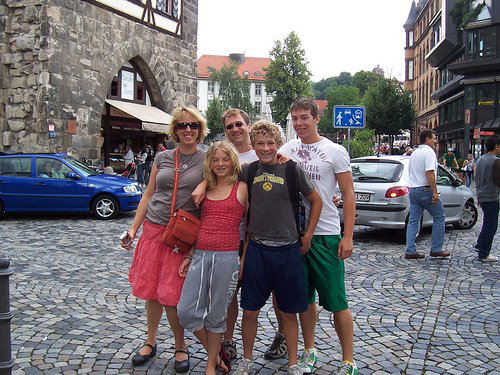

In [93]:
Image.open("/home/fmena/Downloads/Fam2a/1000306439_a1744969b8_1369_11099615@N00.jpg")

In [43]:
imgs = aux["coll"][0][0][7][0] #fimg

for i in range(imgs.shape[0]):
    print(imgs[i][0].shape)
#imgs[0][0].shape

(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(61, 49)
(

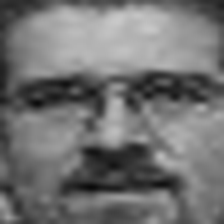

In [146]:

aux = Image.fromarray(imgs[0][0], 'L').convert("RGB")
aux.resize((224,224), Image.ANTIALIAS)

In [12]:
np.random.seed(0)
mask_test = np.random.rand(Z_data.shape[0]) < 0.3

Z_test = Z_data[mask_test]
Z_train = Z_data[~mask_test]

Xstd_train = new_X[~mask_test]
Xstd_test = new_X[mask_test]

print("Input train shape:",Xstd_train.shape)
print("Label train shape:",Z_train.shape)

print("Input test shape:",Xstd_test.shape)
print("Label test shape:",Z_test.shape)

if r_obs.shape[0] != Z_train.shape[0]:
    r_obs = r_obs[~mask_test]

N, K = r_obs.shape

print("repeats shape: ",r_obs.shape)
print("Classes: ",K)

Input train shape: (694, 7, 7, 512)
Label train shape: (694,)
Input test shape: (308, 7, 7, 512)
Label test shape: (308,)
repeats shape:  (694, 6)
Classes:  6


In [24]:
Z_train = Z_data.copy()
Z_test = Z_data_te.copy()

Xstd_train = new_X.copy()
Xstd_test = new_X_te.copy()

print("Input train shape:",Xstd_train.shape)
print("Label train shape:",Z_train.shape)

print("Input test shape:",Xstd_test.shape)
print("Label test shape:",Z_test.shape)


N, K = r_obs.shape
print("repeats shape: ",r_obs.shape)
print("Classes: ",K)

NameError: name 'Z_data_te' is not defined

#### Delta Convergence criteria

In [13]:
from code.learning_models import LogisticRegression_Sklearn,LogisticRegression_Keras,MLP_Keras
#deep learning
from code.learning_models import default_CNN,default_RNN,CNN_simple, RNN_simple, Clonable_Model

from code.utils import EarlyStopRelative
from code.utils import *
from code.representation import *
ourCallback = EarlyStopRelative(monitor='loss',patience=1,min_delta=TOL)

confe_matrix_G = get_Global_confusionM(Z_train,r_obs)

In [14]:
mv_soft = majority_voting(r_obs,repeats=True,probas=True) 
mv_conf_soft = generate_confusionM(mv_soft, r_obs) #confusion matrix of all annotators

mv_onehot = keras.utils.to_categorical(mv_soft.argmax(axis=-1))
mv_conf_onehot = generate_confusionM(mv_onehot, r_obs) #confusion matrix of all annotators

print("ACC MV on train:",np.mean(mv_onehot.argmax(axis=-1)==Z_train))

ACC MV on train: 0.6340057636887608


In [15]:
Z_train_onehot = keras.utils.to_categorical(Z_train, num_classes=K)
Z_test_onehot = keras.utils.to_categorical(Z_test, num_classes=K)

In [132]:
from keras_vggface.vggface import VGGFace
from keras.layers import *
from keras.models import Model

vggface = VGGFace(model='vgg16', include_top=False,input_shape=Xstd_train.shape[1:],pooling=None)

last_layer = vggface.layers[-1].output #.get_layer('pool5').output
#x = Flatten(name='flatten')(last_layer)
x = GlobalAveragePooling2D(name='flatten')(last_layer)

x = Dense(128, activation='relu', name='fc6')(x)
x = Dense(128, activation='relu', name='fc7')(x)
out = Dense(r_obs.shape[1], activation='softmax', name='fc8')(x)
custom_vgg_model = Model(vggface.input, out)
custom_vgg_model.summary()

custom_vgg_model.compile(loss='categorical_crossentropy',optimizer=OPT,metrics=["acc"])
hist=custom_vgg_model.fit(Xstd_train, Z_train_onehot, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=1,
                  callbacks=[ourCallback],
                 validation_data=(Xstd_test,Z_test_onehot)) ##memory error

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_59 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 224, 224, 64)      1792      
_________________________________________________________________
conv1_2 (Conv2D)             (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
conv2_1 (Conv2D)             (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2_2 (Conv2D)             (None, 112, 112, 128)     147584    
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 56, 56, 128)       0         
__________

In [171]:
from keras.models import Sequential

#model_UB = CNN_simple(Xstd_train.shape[1:],r_obs.shape[1], 64, 2, BN=True,drop=0.,double=False,
#                      global_pool=True,dense_units=0) #glob False
model_UB = Sequential()
model_UB.add(Conv2D(128, (3,3), activation='relu', input_shape=Xstd_train.shape[1:], padding='valid'))
model_UB.add(BatchNormalization())
model_UB.add(MaxPool2D(2,2))
#model_UB.add(Conv2D(128, (3,3), activation='relu', padding='same'))
#model_UB.add(BatchNormalization())
#model_UB.add(MaxPool2D(2,2))

#model_UB.add(Flatten())    
model_UB.add(GlobalAveragePooling2D())

model_UB.add(Dense(r_obs.shape[1], activation='softmax'))

#model_UB = CNN_simple(Xstd_train.shape[1:],r_obs.shape[1],1, 1, BN=True,drop=0.0,double=False,
#                      global_pool=False,dense_units=64)

model_UB.summary()
model_UB.compile(loss='categorical_crossentropy',optimizer=OPT,metrics=["acc"])
hist=model_UB.fit(Xstd_train, Z_train_onehot, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=1,
                  callbacks=[ourCallback],
                 validation_data=(Xstd_test,Z_test_onehot))
#K.set_image_data_format('channels_first')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_36 (Conv2D)           (None, 5, 5, 128)         589952    
_________________________________________________________________
batch_normalization_73 (Batc (None, 5, 5, 128)         512       
_________________________________________________________________
max_pooling2d_33 (MaxPooling (None, 2, 2, 128)         0         
_________________________________________________________________
global_average_pooling2d_25  (None, 128)               0         
_________________________________________________________________
dense_111 (Dense)            (None, 5)                 645       
Total params: 591,109
Trainable params: 590,853
Non-trainable params: 256
_________________________________________________________________
Train on 694 samples, validate on 308 samples
Epoch 1/50
694/694 [==============================] - 49s 71ms/step - loss: 1.3366 - acc

In [29]:
model_UB = MLP_Keras(Xstd_train.shape[1:],Z_train_onehot.shape[1],128,1,BN=True,drop=0.5) #128 con 0.5 o 0.25
#model_UB = MLP_Keras(Xstd_train.shape[1:],Z_train_onehot.shape[1],64,2,BN=True,drop=0.25)

model_UB.summary()
model_UB.compile(loss='categorical_crossentropy',optimizer=OPT,metrics=["acc"])
hist=model_UB.fit(Xstd_train, Z_train_onehot, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=1,
                  callbacks=[ourCallback],
                 validation_data=(Xstd_test,Z_test_onehot))
clone_UB = Clonable_Model(model_UB)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               65664     
_________________________________________________________________
batch_normalization_1 (Batch (None, 128)               512       
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 774       
_________________________________________________________________
activation_1 (Activation)    (None, 6)                 0         
Total params: 66,950
Trainable params: 66,694
Non-trainable params: 256
_________________________________________________________________
Trai

In [83]:
model_UB = MLP_Keras(Xstd_train.shape[1:],Z_train_onehot.shape[1],64,1,BN=True,drop=0.25) 

model_UB.summary()
model_UB.compile(loss='categorical_crossentropy',optimizer=OPT,metrics=["acc"])
hist=model_UB.fit(Xstd_train, Z_train_onehot, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=1,
                  callbacks=[ourCallback],
                 validation_data=(Xstd_test,Z_test_onehot))
clone_UB = Clonable_Model(model_UB) 
#resnet

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_39 (InputLayer)        (None, 2048)              0         
_________________________________________________________________
dense_75 (Dense)             (None, 64)                131136    
_________________________________________________________________
batch_normalization_41 (Batc (None, 64)                256       
_________________________________________________________________
dropout_30 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_76 (Dense)             (None, 5)                 325       
_________________________________________________________________
activation_84 (Activation)   (None, 5)                 0         
Total params: 131,717
Trainable params: 131,589
Non-trainable params: 128
_________________________________________________________________
Tr

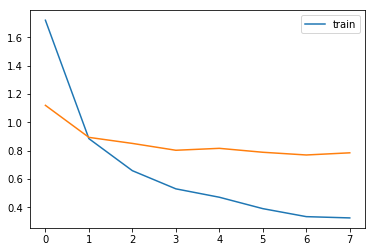

In [34]:
plt.plot(hist.history["loss"],label="train")
plt.plot(hist.history["val_loss"])
plt.legend()

In [26]:
model_mvsoft = clone_UB.get_model()
model_mvsoft.compile(loss='categorical_crossentropy',optimizer=OPT,metrics=["acc"])
hist=model_mvsoft.fit(Xstd_train, mv_soft, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=0,callbacks=[ourCallback])
print("Trained model over soft-MV, Epochs to converge =",len(hist.epoch))
Z_train_pred = model_mvsoft.predict_classes(Xstd_train)
Z_test_pred = model_mvsoft.predict_classes(Xstd_test)

Epoch 1/50
694/694 [==============================] - 2s 3ms/step - loss: 1.4284 - acc: 0.5533
Epoch 2/50
694/694 [==============================] - 0s 285us/step - loss: 1.0258 - acc: 0.7435
Epoch 3/50
694/694 [==============================] - 0s 281us/step - loss: 0.9350 - acc: 0.7896
Epoch 4/50
694/694 [==============================] - 0s 281us/step - loss: 0.8919 - acc: 0.8098
Epoch 5/50
694/694 [==============================] - 0s 276us/step - loss: 0.8699 - acc: 0.8343
Trained model over soft-MV, Epochs to converge = 5


In [28]:
model_mvhard = clone_UB.get_model()
model_mvhard.compile(loss='categorical_crossentropy',optimizer=OPT)
hist=model_mvhard.fit(Xstd_train, mv_onehot, epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=0,callbacks=[ourCallback])
print("Trained model over hard-MV, Epochs to converge =",len(hist.epoch))
Z_train_pred = model_mvhard.predict_classes(Xstd_train)
Z_test_pred = model_mvhard.predict_classes(Xstd_test)

Trained model over hard-MV, Epochs to converge = 15


### Our Proposed

In [16]:
from code.MixtureofGroups import GroupMixtureGlo

aux = []
for example in mv_soft:
    aux.append(entropy(example)/np.log(K))
print("Normalized entropy (0-1) of repeats annotations:",np.mean(aux))

Normalized entropy (0-1) of repeats annotations: 0.3882796182815322


In [ ]:
gMixture_Global = GroupMixtureOpt(Xstd_train.shape[1:],Kl=r_obs.shape[1],M=4,epochs=0,pre_init=0,optimizer=OPT,dtype_op=DTYPE_OP) 
gMixture_Global.define_model("simple cnn",32,3,BatchN=False,drop=0.25,double=True,h_units=512)
gMixture_Global.lambda_random = True 
logL_hists,i_r = gMixture_Global.multiples_run(1,Xstd_train,r_obs,batch_size=BATCH_SIZE,max_iter=0,tolerance=TOL
                               ,cluster=True)

aux = gMixture_Global.alpha_init.sum(axis=1).sum(axis=0)
plt.bar(np.arange(gMixture_Global.M),aux)
plt.show()
gMixture_Global.get_alpha()
plt.bar(np.arange(gMixture_Global.M),gMixture_Global.get_alpha())

In [ ]:
#select M based on JS on train and accuracy on val (as train has ground truth can evaluate JS)
from code.evaluation import Evaluation_metrics
logL_Mchange = []
accTR_Mchange = []
accTE_Mchange = []
best_group_acc_Mchange = []
probas_Mchange = []
divergence1_Mchange = [] #JS Weighted
divergence2_Mchange = [] #JS
probGt_Mchange = []
inertia_Mchange = [] 

R_total= r_obs.sum(axis=-1).sum(axis=-1)
for M_seted in range(1,10+1):
    for _ in range(10):
        gMixture_Global = GroupMixtureOpt(Xstd_train.shape[1:],Kl=r_obs.shape[1],M=M_seted,epochs=1,pre_init=0,optimizer=OPT,dtype_op=DTYPE_OP) 
        gMixture_Global.define_model("simple cnn",32,3,BatchN=False,drop=0.25,double=True,h_units=512)

        
        #to uniform groups...
        print("REVISAAAAAAAR")
        asd
        gMixture_Global.define_priors("laplace")
        gMixture_Global.define_priors(np.tile(R_total*0.1/M_seted,gMixture_Global.M)) 
        
        gMixture_Global.lambda_random = True 
        logL_hists,i_r = gMixture_Global.multiples_run(20,Xstd_train,r_obs,batch_size=BATCH_SIZE,max_iter=EPOCHS_BASE,tolerance=TOL
                                       ,cluster=True)
        
        print("Model with %d trained"%(M_seted))
        logL_Mchange.append(logL_hists[i_r])
        probas_Mchange.append(gMixture_Global.get_alpha())

        #measure metrics..
        evaluate = Evaluation_metrics(gMixture_Global,'our1',plot=False) 
        aux = gMixture_Global.calculate_extra_components(Xstd_train,y_obs,T=T,calculate_pred_annotator=False)
        predictions_m,prob_Gt,prob_Yzt,_ =  aux #to evaluate...
        Z_train_pred = gMixture_Global.base_model.predict_classes(Xstd_train)
        results1 = evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred,conf_pred=prob_Yzt,conf_true=confe_matrix,y_o=y_obs)

        accTR_Mchange.append(results1[0]["Accuracy"][0])
        divergence1_Mchange.append(results1[0]["Mean NormF"][0])
        divergence2_Mchange.append(results1[0]["Mean JS"][0])
        probGt_Mchange.append(prob_Gt)

        c_M = gMixture_Global.get_confusionM()
        y_o_groups = gMixture_Global.get_predictions_groups(Xstd_val).argmax(axis=-1) #obtain p(y^o|x,g=m) and then argmax
        Z_val_pred = gMixture_Global.base_model.predict_classes(Xstd_val)
        results2 = evaluate.calculate_metrics(Z=Z_val,Z_pred=Z_val_pred,conf_pred=c_M, y_o_groups=y_o_groups)

        best_group_acc_Mchange.append(np.max(results2[0]["Accuracy"]))
        accTE_Mchange.append(results2[1]["Accuracy"][0])
        inertia_Mchange.append(evaluate.inertia)
        
        del gMixture_Global,logL_hists,evaluate,predictions_m,prob_Gt,prob_Yzt,Z_train_pred,results1,results2,Z_val_pred
        gc.collect()
        keras.backend.clear_session()
# cada 10 obtener promedio
T_models = 9
R = 10
logL_Mchange = [np.mean( [value[-1] for value in logL_Mchange[i*R:(i+1)*R] ] ) for i in range(T_models)]
accTR_Mchange = [np.mean(accTR_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]
accTE_Mchange = [np.mean(accTE_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]
best_group_acc_Mchange = [np.mean(best_group_acc_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]
probas_Mchange = [np.mean(probas_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]
divergence1_Mchange = [np.mean(divergence1_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)] #KL or JS
divergence2_Mchange = [np.mean(divergence2_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)] #KL or JS
probGt_Mchange = [np.mean(probGt_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]
inertia_Mchange = [np.mean(inertia_Mchange[i*R:(i+1)*R],axis=0) for i in range(T_models)]

In [ ]:
plot_Mchange(logL_Mchange,
         accTR_Mchange,
         accTE_Mchange,
         best_group_acc_Mchange,
         probas_Mchange,
         divergence1_Mchange,
             divergence2_Mchange,
         probGt_Mchange,
         inertia_Mchange
            )

In [ ]:
#T if i know T
print(T)
M_values = range(1,1+len(logL_Mchange))
t = pd.DataFrame()
t["#Groups"] = M_values
t[">=1 annotator"] = [ np.sum(probas*T >= 1) for probas in probas_Mchange]
t[">=2 annotator"] = [ np.sum(probas*T >= 2) for probas in probas_Mchange] #si agrupa al menos tiene 2
t["Used on annotators"] = [ len(np.unique(prob_Gt.argmax(axis=1))) for prob_Gt in probGt_Mchange ]#based on p(g|t)
t["Used on annotators limit >=0.01"] = [ np.sum(prob_Gt.max(axis=0)>=0.01) for prob_Gt in probGt_Mchange ]#based on p(g|t)
t["Used on annotators limit >=0.05"] = [ np.sum(prob_Gt.max(axis=0)>=0.05) for prob_Gt in probGt_Mchange ]#based on p(g|t)
t

In [35]:
M_seted = 3 #??

""" AÑADIR A ARCHIVO GROUPS..."""
def define_uniform_groups(power, r, M):
    R_total = r.sum()
    uniform_groups = np.asarray([power*R_total/M for _ in range(M)])
    return uniform_groups
uniform = True
if uniform:
    uniform_groups = define_uniform_groups(0.1, r_obs, M_seted)
    print(uniform_groups)

[231.33333333 231.33333333 231.33333333]


In [36]:
gMixture_Global = GroupMixtureGlo(Xstd_train.shape[1:],Kl=r_obs.shape[1],M=M_seted,epochs=1,optimizer=OPT,dtype_op=DTYPE_OP) 
gMixture_Global.define_model("simple cnn",128, 1, BatchN=True,drop=0.25,double=False,h_units=0,glo_p=True )
if uniform:
    gMixture_Global.define_priors("laplace")
    gMixture_Global.define_priors(uniform_groups)

logL_hists,i_r = gMixture_Global.multiples_run(20,Xstd_train,r_obs,batch_size=BATCH_SIZE,max_iter=EPOCHS_BASE,tolerance=TOL)

Needed params (units,deep,drop,double?,BatchN?)
Remember to prior bethas
Initializing new EM...
Doing clustering...Done!
Get init alphas in 0.003549 mins
Lambda by group:  [1. 1. 1.]
Alphas:  (3,)
MV init:  (694, 6)
Betas:  (3, 6, 6)
Q estimate:  (694, 6, 3, 6)
Iter 1/50
M step: done,  E step: done //  (in 1.78 sec)	logL: -7461.942	
Iter 2/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6756.516	Tol1: 0.09454	Tol2: 0.54877	Tol3: 0.07146	
Iter 3/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6484.845	Tol1: 0.04021	Tol2: 0.27316	Tol3: 0.04447	
Iter 4/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6342.138	Tol1: 0.02201	Tol2: 0.15288	Tol3: 0.04261	
Iter 5/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6272.589	Tol1: 0.01097	Tol2: 0.08607	Tol3: 0.03534	
Iter 6/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6196.770	Tol1: 0.01209	Tol2: 0.07899	Tol3: 0.03278	
Iter 7/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6159.297	Tol1: 0.00605	Tol2

M step: done,  E step: done //  (in 0.33 sec)	logL: -5791.156	Tol1: 0.00490	Tol2: 0.08271	Tol3: 0.02378	
Iter 19/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5815.784	Tol1: 0.00425	Tol2: 0.08134	Tol3: 0.02286	
Iter 20/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5820.211	Tol1: 0.00076	Tol2: 0.07837	Tol3: 0.02561	
Iter 21/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6016.697	Tol1: 0.03376	Tol2: 0.09105	Tol3: 0.02164	
Iter 22/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6036.788	Tol1: 0.00334	Tol2: 0.13829	Tol3: 0.03201	
Iter 23/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5997.095	Tol1: 0.00658	Tol2: 0.08132	Tol3: 0.03165	
Iter 24/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5946.686	Tol1: 0.00841	Tol2: 0.08850	Tol3: 0.02632	
Iter 25/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5843.849	Tol1: 0.01729	Tol2: 0.06263	Tol3: 0.02294	
Iter 26/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5826.503	Tol1: 0.00

M step: done,  E step: done //  (in 0.32 sec)	logL: -5769.144	Tol1: 0.00546	Tol2: 0.08633	Tol3: 0.01405	
Iter 38/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5709.182	Tol1: 0.01039	Tol2: 0.07192	Tol3: 0.00934	
Iter 39/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5646.195	Tol1: 0.01103	Tol2: 0.06923	Tol3: 0.01958	
Iter 40/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5689.528	Tol1: 0.00767	Tol2: 0.05448	Tol3: 0.01290	
Iter 41/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5624.952	Tol1: 0.01135	Tol2: 0.10440	Tol3: 0.02870	
Iter 42/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5633.633	Tol1: 0.00154	Tol2: 0.08869	Tol3: 0.01872	
Iter 43/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5712.027	Tol1: 0.01392	Tol2: 0.06790	Tol3: 0.01559	
Iter 44/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5664.687	Tol1: 0.00829	Tol2: 0.10550	Tol3: 0.01147	
Iter 45/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5806.927	Tol1: 0.02

M step: done,  E step: done //  (in 0.32 sec)	logL: -6194.633	Tol1: 0.01179	Tol2: 0.13402	Tol3: 0.04996	
Iter 5/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6094.349	Tol1: 0.01619	Tol2: 0.09386	Tol3: 0.04027	
Iter 6/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6026.555	Tol1: 0.01112	Tol2: 0.08086	Tol3: 0.03470	
Iter 7/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6015.861	Tol1: 0.00177	Tol2: 0.07482	Tol3: 0.03235	
Iter 8/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5935.970	Tol1: 0.01328	Tol2: 0.08078	Tol3: 0.02753	
Iter 9/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5892.885	Tol1: 0.00726	Tol2: 0.06651	Tol3: 0.02528	
Iter 10/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5868.529	Tol1: 0.00413	Tol2: 0.05491	Tol3: 0.02289	
Iter 11/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5854.701	Tol1: 0.00236	Tol2: 0.05472	Tol3: 0.02258	
Iter 12/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5816.010	Tol1: 0.00661	T

M step: done,  E step: done //  (in 0.32 sec)	logL: -5721.548	Tol1: 0.00872	Tol2: 0.08884	Tol3: 0.01810	
Iter 24/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5815.416	Tol1: 0.01641	Tol2: 0.05998	Tol3: 0.01447	
Iter 25/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5745.235	Tol1: 0.01207	Tol2: 0.12228	Tol3: 0.01550	
Iter 26/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5745.957	Tol1: 0.00013	Tol2: 0.10883	Tol3: 0.01580	
Iter 27/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5752.688	Tol1: 0.00117	Tol2: 0.08943	Tol3: 0.01595	
Iter 28/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5703.445	Tol1: 0.00856	Tol2: 0.10042	Tol3: 0.01384	
Iter 29/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5685.122	Tol1: 0.00321	Tol2: 0.05939	Tol3: 0.01148	
Iter 30/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5644.769	Tol1: 0.00710	Tol2: 0.06907	Tol3: 0.01324	
Iter 31/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5605.008	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -6096.555	Tol1: 0.00472	Tol2: 0.11244	Tol3: 0.00682	
Iter 13/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6099.291	Tol1: 0.00045	Tol2: 0.07998	Tol3: 0.01266	
Iter 14/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6059.709	Tol1: 0.00649	Tol2: 0.12944	Tol3: 0.03270	
Iter 15/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5960.687	Tol1: 0.01634	Tol2: 0.10880	Tol3: 0.03429	
Iter 16/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5947.962	Tol1: 0.00213	Tol2: 0.07353	Tol3: 0.02381	
Iter 17/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5929.662	Tol1: 0.00308	Tol2: 0.06427	Tol3: 0.01548	
Iter 18/50
M step: done,  E step: done //  (in 0.35 sec)	logL: -5878.942	Tol1: 0.00855	Tol2: 0.06595	Tol3: 0.01845	
Iter 19/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5874.904	Tol1: 0.00069	Tol2: 0.09965	Tol3: 0.01382	
Iter 20/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5852.556	Tol1: 0.00

M step: done,  E step: done //  (in 0.34 sec)	logL: -5633.159	Tol1: 0.00310	Tol2: 0.05537	Tol3: 0.00792	
Iter 32/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5592.023	Tol1: 0.00730	Tol2: 0.05963	Tol3: 0.00847	
Iter 33/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5567.257	Tol1: 0.00443	Tol2: 0.04335	Tol3: 0.00550	
Iter 34/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5583.872	Tol1: 0.00298	Tol2: 0.04368	Tol3: 0.00714	
Iter 35/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5562.016	Tol1: 0.00391	Tol2: 0.06400	Tol3: 0.00772	
Iter 36/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5554.838	Tol1: 0.00129	Tol2: 0.07891	Tol3: 0.00678	
Iter 37/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5516.382	Tol1: 0.00692	Tol2: 0.09092	Tol3: 0.00552	
Iter 38/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5493.970	Tol1: 0.00406	Tol2: 0.07192	Tol3: 0.00432	
Iter 39/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5546.211	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -5661.293	Tol1: 0.00288	Tol2: 0.11052	Tol3: 0.00412	
Finished training!
Initializing new EM...
Doing clustering...Done!
Get init alphas in 0.003784 mins
Lambda by group:  [1. 1. 1.]
Alphas:  (3,)
MV init:  (694, 6)
Betas:  (3, 6, 6)
Q estimate:  (694, 6, 3, 6)
Iter 1/50
M step: done,  E step: done //  (in 1.42 sec)	logL: -7454.466	
Iter 2/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -7099.576	Tol1: 0.04761	Tol2: 0.54112	Tol3: 0.02878	
Iter 3/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6751.720	Tol1: 0.04900	Tol2: 0.30282	Tol3: 0.04960	
Iter 4/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6436.422	Tol1: 0.04670	Tol2: 0.13509	Tol3: 0.05986	
Iter 5/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6294.320	Tol1: 0.02208	Tol2: 0.12306	Tol3: 0.05375	
Iter 6/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6199.026	Tol1: 0.01514	Tol2: 0.09311	Tol3: 0.04289	
Iter 7/50
M step: done,  E step: done /

M step: done,  E step: done //  (in 0.32 sec)	logL: -5763.737	Tol1: 0.00718	Tol2: 0.05594	Tol3: 0.02365	
Iter 19/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5730.018	Tol1: 0.00585	Tol2: 0.07015	Tol3: 0.02288	
Iter 20/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5773.260	Tol1: 0.00755	Tol2: 0.06072	Tol3: 0.02101	
Iter 21/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5701.352	Tol1: 0.01246	Tol2: 0.10571	Tol3: 0.02698	
Iter 22/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5684.690	Tol1: 0.00292	Tol2: 0.05122	Tol3: 0.02249	
Iter 23/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5650.910	Tol1: 0.00594	Tol2: 0.05154	Tol3: 0.01830	
Iter 24/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5633.705	Tol1: 0.00304	Tol2: 0.06370	Tol3: 0.01013	
Iter 25/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5614.614	Tol1: 0.00339	Tol2: 0.06298	Tol3: 0.01154	
Iter 26/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5628.058	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -5408.924	Tol1: 0.00256	Tol2: 0.05495	Tol3: 0.00338	
Finished training!
Initializing new EM...
Doing clustering...Done!
Get init alphas in 0.003545 mins
Lambda by group:  [1. 1. 1.]
Alphas:  (3,)
MV init:  (694, 6)
Betas:  (3, 6, 6)
Q estimate:  (694, 6, 3, 6)
Iter 1/50
M step: done,  E step: done //  (in 1.41 sec)	logL: -7207.333	
Iter 2/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6548.953	Tol1: 0.09135	Tol2: 0.50244	Tol3: 0.04787	
Iter 3/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6359.528	Tol1: 0.02892	Tol2: 0.22247	Tol3: 0.04470	
Iter 4/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6240.621	Tol1: 0.01870	Tol2: 0.11780	Tol3: 0.04641	
Iter 5/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -6145.184	Tol1: 0.01529	Tol2: 0.08920	Tol3: 0.04313	
Iter 6/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6113.649	Tol1: 0.00513	Tol2: 0.07916	Tol3: 0.04136	
Iter 7/50
M step: done,  E step: done /

M step: done,  E step: done //  (in 0.32 sec)	logL: -5816.777	Tol1: 0.00192	Tol2: 0.08820	Tol3: 0.02362	
Iter 19/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5822.701	Tol1: 0.00102	Tol2: 0.06601	Tol3: 0.02502	
Iter 20/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5757.128	Tol1: 0.01126	Tol2: 0.05864	Tol3: 0.02299	
Iter 21/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5712.937	Tol1: 0.00768	Tol2: 0.07865	Tol3: 0.02000	
Iter 22/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5676.619	Tol1: 0.00636	Tol2: 0.06541	Tol3: 0.02550	
Iter 23/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5638.070	Tol1: 0.00679	Tol2: 0.05719	Tol3: 0.03015	
Iter 24/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5667.671	Tol1: 0.00525	Tol2: 0.08336	Tol3: 0.01443	
Iter 25/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5624.573	Tol1: 0.00760	Tol2: 0.06894	Tol3: 0.01804	
Iter 26/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5597.942	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -5656.026	Tol1: 0.01346	Tol2: 0.05751	Tol3: 0.00743	
Iter 38/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5668.696	Tol1: 0.00224	Tol2: 0.06452	Tol3: 0.00924	
Iter 39/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5651.392	Tol1: 0.00305	Tol2: 0.06535	Tol3: 0.00614	
Iter 40/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5611.491	Tol1: 0.00706	Tol2: 0.04996	Tol3: 0.00787	
Iter 41/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5618.990	Tol1: 0.00134	Tol2: 0.03940	Tol3: 0.00790	
Iter 42/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5534.884	Tol1: 0.01497	Tol2: 0.06888	Tol3: 0.01026	
Iter 43/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5526.950	Tol1: 0.00143	Tol2: 0.03897	Tol3: 0.00556	
Iter 44/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5480.297	Tol1: 0.00844	Tol2: 0.04701	Tol3: 0.00614	
Iter 45/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5458.171	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -6257.408	Tol1: 0.01329	Tol2: 0.13375	Tol3: 0.05400	
Iter 5/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6165.081	Tol1: 0.01475	Tol2: 0.10575	Tol3: 0.05300	
Iter 6/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6092.731	Tol1: 0.01174	Tol2: 0.07072	Tol3: 0.03577	
Iter 7/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6019.894	Tol1: 0.01195	Tol2: 0.07162	Tol3: 0.02947	
Iter 8/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -6017.862	Tol1: 0.00034	Tol2: 0.08250	Tol3: 0.02385	
Iter 9/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5946.915	Tol1: 0.01179	Tol2: 0.09630	Tol3: 0.02448	
Iter 10/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5951.944	Tol1: 0.00085	Tol2: 0.07267	Tol3: 0.01254	
Iter 11/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5959.903	Tol1: 0.00134	Tol2: 0.08533	Tol3: 0.02071	
Iter 12/50
M step: done,  E step: done //  (in 0.32 sec)	logL: -5847.279	Tol1: 0.01890	T

M step: done,  E step: done //  (in 0.33 sec)	logL: -5967.652	Tol1: 0.00302	Tol2: 0.09983	Tol3: 0.03631	
Iter 24/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5842.974	Tol1: 0.02089	Tol2: 0.14892	Tol3: 0.02387	
Iter 25/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5779.016	Tol1: 0.01095	Tol2: 0.06337	Tol3: 0.01978	
Iter 26/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5794.359	Tol1: 0.00265	Tol2: 0.05555	Tol3: 0.01908	
Iter 27/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5751.134	Tol1: 0.00746	Tol2: 0.07112	Tol3: 0.01585	
Iter 28/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5700.686	Tol1: 0.00877	Tol2: 0.04894	Tol3: 0.01579	
Iter 29/50
M step: done,  E step: done //  (in 0.35 sec)	logL: -5661.866	Tol1: 0.00681	Tol2: 0.08758	Tol3: 0.02553	
Iter 30/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -5605.883	Tol1: 0.00989	Tol2: 0.08509	Tol3: 0.01961	
Iter 31/50
M step: done,  E step: done //  (in 0.34 sec)	logL: -5596.711	Tol1: 0.00

M step: done,  E step: done //  (in 0.33 sec)	logL: -11597.650	Tol1: 0.00151	Tol2: 0.03785	Tol3: 0.00498	
Iter 43/50
M step: done,  E step: done //  (in 0.33 sec)	logL: -11558.347	Tol1: 0.00339	Tol2: 0.02510	Tol3: 0.00439	
Finished training!
Multiples runs over Ours Global, Epochs to converge=  47.95


In [37]:
Z_train_p = gMixture_Global.base_model.predict(Xstd_train)
Z_train_pred = Z_train_p.argmax(axis=-1)
Z_test_p = gMixture_Global.base_model.predict(Xstd_test)
Z_test_pred = Z_test_p.argmax(axis=-1)
y_o_groups = gMixture_Global.get_predictions_groups(Xstd_test,data=Z_test_p).argmax(axis=-1)

### Compare trained models

In [21]:
#Import it:
from code.evaluation import Evaluation_metrics

In [23]:
#model_UB = MLP_Keras(Xstd_train.shape[1:],Z_train_onehot.shape[1],128,1,BN=True,drop=0.0)
model_UB = CNN_simple(Xstd_train.shape[1:],r_obs.shape[1],128,1, BN=True,drop=0.25,double=False,
                      global_pool=True,dense_units=0)
clone_UB = Clonable_Model(model_UB)

In [24]:
aux_tr = []
aux_te = []
eps = []
for _ in range(20):
    model_UB = clone_UB.get_model()
    model_UB.compile(loss='categorical_crossentropy',optimizer=OPT)
    hist = model_UB.fit(Xstd_train,Z_train_onehot,epochs=EPOCHS_BASE,batch_size=BATCH_SIZE,verbose=0,callbacks=[ourCallback])
    Z_train_pred = model_UB.predict_classes(Xstd_train)
    Z_test_pred = model_UB.predict_classes(Xstd_test)

    evaluate = Evaluation_metrics(model_UB,'keras',Xstd_train.shape[0], plot=False)
    aux_tr += evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred)
    aux_te += evaluate.calculate_metrics(Z=Z_test,Z_pred=Z_test_pred)
    eps.append(len(hist.epoch))
    
print("Epochs: ",np.mean(eps))
final_tr_m = get_mean_dataframes(aux_tr)#.to_csv("LabelMe_Ideal_train.csv",index=False)
final_tr_std = get_mean_dataframes(aux_tr, mean_std=False)#.to_csv("LabelMe_Ideal_train_std.csv",index=False)
final_te_m = get_mean_dataframes(aux_te)#.to_csv("LabelMe_Ideal_test.csv",index=False)
final_te_std = get_mean_dataframes(aux_te, mean_std=False)#.to_csv("LabelMe_Ideal_test_std.csv",index=False)
final_tr_m.merge(final_tr_std.iloc[:,1:], left_index=True, right_index=True)

Epochs:  18.95


,,Accuracy_x,F1 (micro)_x,F1 (macro)_x,Accuracy_y,F1 (micro)_y,F1 (macro)_y
0,All,1,1,1,0,0,0


In [25]:
final_te_m.merge(final_te_std.iloc[:,1:], left_index=True, right_index=True)

,,Accuracy_x,F1 (micro)_x,F1 (macro)_x,Accuracy_y,F1 (micro)_y,F1 (macro)_y
0,All,0.680519,0.680519,0.583983,0.011029,0.011029,0.017848


* VGG Face
    * standarize
        * bn y dropa 0.5  : 68
        * bn y dropa 0.25 : 67
        * bn y dropa: 0.0 : 67
     * normal
        * bn y dropa 0.5  : 68.7
        * bn y dropa 0.25 : 69.4
        * bn y dropa 0.0  : 69
        * bn(256) y drop 0.25: 
     * Entrenando (None):
        * bn(128) dropa 0: 69.6, con drop 0.25: 69.8
     
* ResNet
    * standarize
        * bn y dropa 0.5  : 68-9
        * bn y dropa 0.25 : 68
        * bn y dropa: 0.0 : 68
     * normal
        * bn y dropa 0.5  : 68-9
        * bn y dropa 0.25 : 68
        * bn y dropa 0.0  : 68

*** Soft-Majority (Train with softMV) ***
Train
Calculate confusion matrix on global version


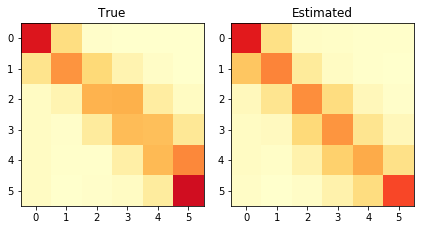

JS divergence: 0.052	Norm Frobenius: 0.096
A result


,,Accuracy,F1 (micro),F1 (macro),(G) NormF,(G) JS
0,All,0.6354,0.6354,0.5553,0.0958,0.0517


Test
A result


,,Accuracy,F1 (micro),F1 (macro)
0,All,0.6299,0.6299,0.5203


In [27]:
evaluate = Evaluation_metrics(model_mvsoft,'keras',Xstd_train.shape[0])
print("*** Soft-Majority (Train with softMV) ***")

print("Train")
results1 = evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred,
                                      conf_true_G =confe_matrix_G, conf_pred_G = mv_conf_soft)

print("Test")
results2 = evaluate.calculate_metrics(Z=Z_test,Z_pred=Z_test_pred)

*** Hard-Majority (Train with hardMV) ***
Train
Calculate confusion matrix on global version


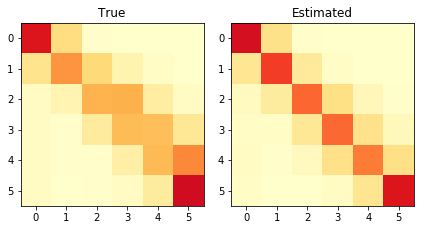

JS divergence: 0.040	Norm Frobenius: 0.100
A result


,,Accuracy,F1 (micro),F1 (macro),(G) NormF,(G) JS
0,All,0.634,0.634,0.5453,0.1002,0.0403


Test
A result


,,Accuracy,F1 (micro),F1 (macro)
0,All,0.6461,0.6461,0.5527


In [29]:
evaluate = Evaluation_metrics(model_mvhard,'keras',Xstd_train.shape[0])
print("*** Hard-Majority (Train with hardMV) ***")

print("Train")
results1 = evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred,
                                      conf_true_G =confe_matrix_G, conf_pred_G = mv_conf_onehot)

print("Test")
results2 = evaluate.calculate_metrics(Z=Z_test,Z_pred=Z_test_pred)

*** Ours Global multiples runs***
Train
Calculate confusion matrix on global version


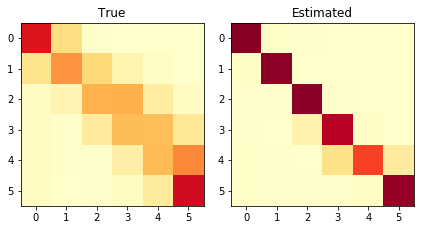

JS divergence: 0.196	Norm Frobenius: 0.213
A result


,,Accuracy,F1 (micro),F1 (macro),(G) NormF,(G) JS
0,All,0.5951,0.5951,0.5154,0.2128,0.1961


Test


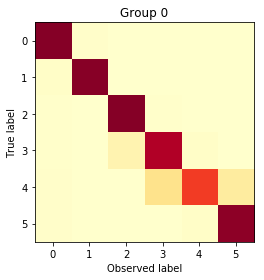

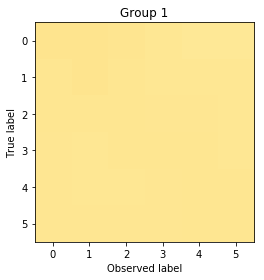

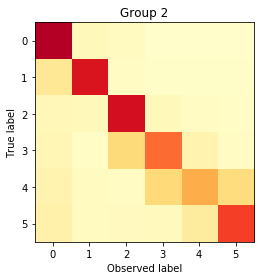

Inertia JS: 0.294287197917867
Inertia NormF: 0.23218664978576106
A result


,Groups,Prob,Entropy,Diag mean,Isim (JS),S_raykar,S_bias,C_bias,Iner JS,Iner NormF,Accuracy,F1 (micro)
0,0,0.9412,0.3010,0.9147,0.9530,0.8976,0.0085,5,0.2943,0.2322,0.6396,0.6396
1,1,0.0004,1.7912,0.1723,0.3530,0.0068,0.0034,0,0.2943,0.2322,0.3182,0.3182
2,2,0.0584,0.9802,0.6805,0.8085,0.6166,0.0648,0,0.2943,0.2322,0.6331,0.6331


A result


,,Accuracy,F1 (micro),F1 (macro)
0,All,0.6299,0.6299,0.54


In [33]:
evaluate = Evaluation_metrics(gMixture_Global,'our1') 
#aux = gMixture_Global.calculate_extra_components(Xstd_train,y_obs,T=T,calculate_pred_annotator=False,p_z=Z_train_p)
#predictions_m,prob_Gt,prob_Yzt,prob_Yxt =  aux #to evaluate...
#evaluate.labels_plot = labels
print("*** Ours Global multiples runs***")

print("Train")
prob_Yz = gMixture_Global.calculate_Yz()
results = evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred, 
                                    conf_true_G =confe_matrix_G, conf_pred_G = prob_Yz)

print("Test")
c_M = gMixture_Global.get_confusionM()
results = evaluate.calculate_metrics(Z=Z_test,Z_pred=Z_test_pred,conf_pred=c_M, y_o_groups= y_o_groups)

*** Ours Global multiples runs (uniform) ***
Train
Calculate confusion matrix on global version


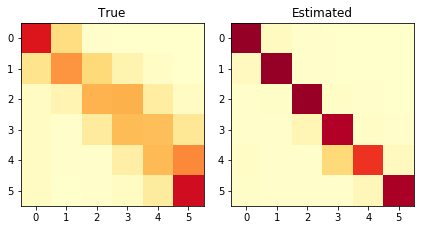

JS divergence: 0.194	Norm Frobenius: 0.215
A result


,,Accuracy,F1 (micro),F1 (macro),(G) NormF,(G) JS
0,All,0.5922,0.5922,0.5009,0.2151,0.1939


Test


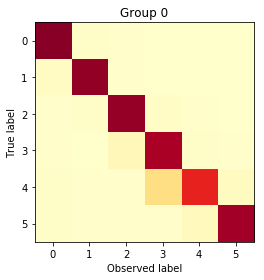

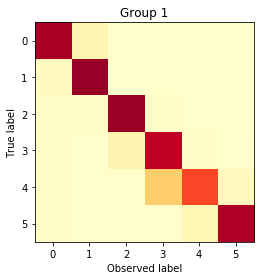

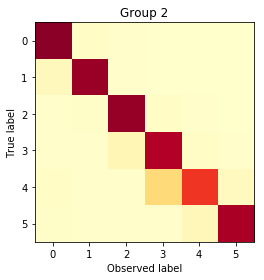

Inertia JS: 0.003132860353002962
Inertia NormF: 0.018850285998712524
A result


,Groups,Prob,Entropy,Diag mean,Isim (JS),S_raykar,S_bias,C_bias,Iner JS,Iner NormF,Accuracy,F1 (micro)
0,0,0.3564,0.3595,0.9098,0.9518,0.8917,0.0223,3,0.0031,0.0189,0.5909,0.5909
1,1,0.3113,0.4636,0.8695,0.9287,0.8433,0.0256,3,0.0031,0.0189,0.6039,0.6039
2,2,0.3322,0.4045,0.8927,0.9420,0.8712,0.0253,3,0.0031,0.0189,0.5974,0.5974


A result


,,Accuracy,F1 (micro),F1 (macro)
0,All,0.5877,0.5877,0.4762


In [38]:
evaluate = Evaluation_metrics(gMixture_Global,'our1') 
#aux = gMixture_Global.calculate_extra_components(Xstd_train,y_obs,T=T,calculate_pred_annotator=False,p_z=Z_train_p)
#predictions_m,prob_Gt,prob_Yzt,prob_Yxt =  aux #to evaluate...
#evaluate.labels_plot = labels
print("*** Ours Global multiples runs (uniform) ***")

print("Train")
prob_Yz = gMixture_Global.calculate_Yz()
results = evaluate.calculate_metrics(Z=Z_train,Z_pred=Z_train_pred, 
                                    conf_true_G =confe_matrix_G, conf_pred_G = prob_Yz)

print("Test")
c_M = gMixture_Global.get_confusionM()
results = evaluate.calculate_metrics(Z=Z_test,Z_pred=Z_test_pred,conf_pred=c_M, y_o_groups= y_o_groups)